In [1]:
import pandas as pd
import numpy as np
import seaborn as sns

import plotly.graph_objects as go
import matplotlib.pyplot as plt

from IPython.display import display
from plotly.subplots import make_subplots

# Load data

## train

In [2]:
train_dataset = pd.read_csv("../dataset/train.csv") 

In [3]:
display(train_dataset.head())

print(f"train_dataset.shape - {train_dataset.shape}")

,rate,valid_miles,transport_type,weight,pickup_date,origin_kma,destination_kma
0,4.7203,521.8451,MKPFX,9231.75,2019-11-10 10:42:00,OMUOI,LFUHN
1,4.9005,532.6675,MKPFX,11754.95,2019-11-10 10:42:00,OMUOI,LFUHN
2,4.7018,523.9188,MKPFX,9603.20,2019-11-10 10:42:00,OMUOI,LFUHN
3,4.6388,562.8296,MKPFX,8789.05,2019-11-10 10:42:00,OMUOI,LFUHN
4,5.0206,519.8782,MKPFX,9597.50,2019-11-10 10:42:00,OMUOI,LFUHN


train_dataset.shape - (296727, 7)


## val

In [4]:
val_dataset = pd.read_csv("../dataset/validation.csv") 

In [5]:
display(val_dataset.head())

print(f"val_dataset.shape - {val_dataset.shape}")

,rate,valid_miles,transport_type,weight,pickup_date,origin_kma,destination_kma
0,3.7814,712.5632,GJROY,5351.0000,2022-09-05 20:42:00,RMBXT,QGHCU
1,6.6884,805.9865,MKPFX,42111.2500,2022-09-05 20:42:00,ZUVHM,LFUHN
2,3.7735,952.7475,MKPFX,14609.7000,2022-09-05 20:42:00,UKWZA,NPCXM
3,8.4960,65.4620,MKPFX,7192.1000,2022-09-05 20:42:00,JESUD,NTODX
4,3.6423,1496.5464,MKPFX,6195.6451,2022-09-05 20:42:00,GKKOS,TVZUE


val_dataset.shape - (5000, 7)


## test

In [6]:
test_dataset = pd.read_csv("../dataset/test.csv") 

In [7]:
display(test_dataset.head())

print(f"test_dataset.shape - {test_dataset.shape}")

,valid_miles,transport_type,weight,pickup_date,origin_kma,destination_kma
0,744.4786,MKPFX,32616.95,2022-09-22 08:42:00,QWBPO,FKQGG
1,748.7150,MKPFX,39950.00,2022-09-22 08:42:00,LFUHN,EKGTE
2,650.1920,MKPFX,39950.00,2022-09-22 08:42:00,QGHCU,EKGTE
3,650.1920,MKPFX,39950.00,2022-09-22 08:42:00,QGHCU,EKGTE
4,650.1920,MKPFX,39950.00,2022-09-22 08:42:00,QGHCU,EKGTE


test_dataset.shape - (5000, 6)


# Missed data

## train

In [8]:
train_dataset.isna().sum()

rate                0
valid_miles         0
transport_type      0
weight             80
pickup_date         0
origin_kma          0
destination_kma     0
dtype: int64

## val

In [9]:
val_dataset.isna().sum()

rate               0
valid_miles        0
transport_type     0
weight             0
pickup_date        0
origin_kma         0
destination_kma    0
dtype: int64

## test

In [10]:
test_dataset.isna().sum()

valid_miles        0
transport_type     0
weight             0
pickup_date        0
origin_kma         0
destination_kma    0
dtype: int64

# Duplicates

## train

In [11]:
train_dataset.duplicated().sum()

np.int64(10381)

In [12]:
train_dataset.loc[
    train_dataset.duplicated(keep=False)
].head(15)

,rate,valid_miles,transport_type,weight,pickup_date,origin_kma,destination_kma
108,4.9798,293.9695,MKPFX,39095.00,2019-11-11 10:42:00,VJBFX,DNDBK
109,4.9798,293.9695,MKPFX,39095.00,2019-11-11 10:42:00,VJBFX,DNDBK
169,4.9871,319.9931,GJROY,23800.00,2019-11-12 10:42:00,ZYKLC,QUERU
189,4.9871,319.9931,GJROY,23800.00,2019-11-12 10:42:00,ZYKLC,QUERU
190,3.8027,299.4430,MKPFX,23800.00,2019-11-12 10:42:00,VCEUE,OUHDS
192,6.1861,236.2530,MKPFX,23800.00,2019-11-12 10:42:00,VCEUE,DNDBK
211,3.8027,299.4430,MKPFX,23800.00,2019-11-12 10:42:00,VCEUE,OUHDS
213,2.8196,578.7873,MKPFX,28550.00,2019-11-12 10:42:00,QUERU,FPZNC
214,6.1861,236.2530,MKPFX,23800.00,2019-11-12 10:42:00,VCEUE,DNDBK
231,2.8196,578.7873,MKPFX,28550.00,2019-11-12 10:42:00,QUERU,FPZNC


## val

In [13]:
val_dataset.duplicated().sum()

np.int64(245)

In [14]:
val_dataset.loc[
    val_dataset.duplicated(keep=False)
].head(15)

,rate,valid_miles,transport_type,weight,pickup_date,origin_kma,destination_kma
17,4.5741,785.6500,GJROY,41850.0,2022-09-05 22:42:00,NTODX,VCEUE
18,4.5741,785.6500,GJROY,41850.0,2022-09-05 22:42:00,NTODX,VCEUE
82,6.4120,789.7173,MKPFX,37100.0,2022-09-06 08:42:00,MJJOV,PEXPT
97,6.4120,789.7173,MKPFX,37100.0,2022-09-06 08:42:00,MJJOV,PEXPT
99,6.4120,789.7173,MKPFX,37100.0,2022-09-06 08:42:00,MJJOV,PEXPT
100,7.8562,394.0500,MKPFX,33300.0,2022-09-06 08:42:00,PEXPT,LHDSM
101,4.4587,806.0132,MKPFX,12933.9,2022-09-06 08:42:00,RCDSS,OKWUS
107,12.6143,95.3660,MKPFX,33300.0,2022-09-06 08:42:00,PEXPT,QGHCU
108,12.6143,95.3660,MKPFX,33300.0,2022-09-06 08:42:00,PEXPT,QGHCU
109,12.6143,95.3660,MKPFX,33300.0,2022-09-06 08:42:00,PEXPT,QGHCU


## test

In [15]:
test_dataset.duplicated().sum()

np.int64(371)

In [16]:
test_dataset.loc[
    test_dataset.duplicated(keep=False)
].head(15)

,valid_miles,transport_type,weight,pickup_date,origin_kma,destination_kma
1,748.7150,MKPFX,39950.00,2022-09-22 08:42:00,LFUHN,EKGTE
2,650.1920,MKPFX,39950.00,2022-09-22 08:42:00,QGHCU,EKGTE
3,650.1920,MKPFX,39950.00,2022-09-22 08:42:00,QGHCU,EKGTE
4,650.1920,MKPFX,39950.00,2022-09-22 08:42:00,QGHCU,EKGTE
6,885.3300,MKPFX,41047.25,2022-09-22 08:42:00,OKPES,JHFLR
7,885.3300,MKPFX,41047.25,2022-09-22 08:42:00,OKPES,JHFLR
8,885.3300,MKPFX,41047.25,2022-09-22 08:42:00,OKPES,JHFLR
9,885.3300,MKPFX,41047.25,2022-09-22 08:42:00,OKPES,JHFLR
10,885.3300,MKPFX,41047.25,2022-09-22 08:42:00,OKPES,JHFLR
11,2310.9231,GJROY,39950.00,2022-09-22 08:42:00,RONUZ,OQOLJ


# Clean data

In [17]:
train_data = train_dataset.copy()
val_data = val_dataset.copy()
test_data = test_dataset.copy()

## remove missed data

In [18]:
print(f"before removing missed data train.shape - {train_data.shape}")

train_data.dropna(
    how="any",
    inplace=True
)

print(f"after removing missed data train.shape - {train_data.shape}")

before removing missed data train.shape - (296727, 7)
after removing missed data train.shape - (296647, 7)


## remove duplicates

In [19]:
print(f"before removing duplicates train.shape - {train_data.shape}")

train_data.drop_duplicates(
    inplace=True
)

print(f"after removing duplicates train.shape - {train_data.shape}")

before removing duplicates train.shape - (296647, 7)
after removing duplicates train.shape - (286267, 7)


In [20]:
print(f"before removing duplicates val.shape - {val_data.shape}")

val_data.drop_duplicates(
    inplace=True
)

print(f"after removing duplicates val.shape - {val_data.shape}")

before removing duplicates val.shape - (5000, 7)
after removing duplicates val.shape - (4755, 7)


In [21]:
print(f"before removing duplicates test.shape - {test_data.shape}")

test_data.drop_duplicates(
    inplace=True
)

print(f"after removing duplicates test.shape - {test_data.shape}")

before removing duplicates test.shape - (5000, 6)
after removing duplicates test.shape - (4629, 6)


# EDA

## rate

In [22]:
train_rate_data = train_data["rate"].values
val_rate_data = val_data["rate"].values

train_q01 = np.quantile(train_rate_data, q=.01)
train_q99 = np.quantile(train_rate_data, q=.99) 

val_q01= np.quantile(val_rate_data, q=.01)
val_q99 = np.quantile(val_rate_data, q=.99) 


# get indices
train_rate_idx = np.where(
    # (train_q01 <= train_rate_data) & (train_rate_data <= train_q99)
    train_rate_data <= train_q99
)

val_rate_idx = np.where(
    # (val_q01 <= val_rate_data) & (val_rate_data <= val_q99)
    val_rate_data <= val_q99
)


train_rate_data_clear = train_rate_data[train_rate_idx]
val_rate_data_clear = val_rate_data[val_rate_idx]

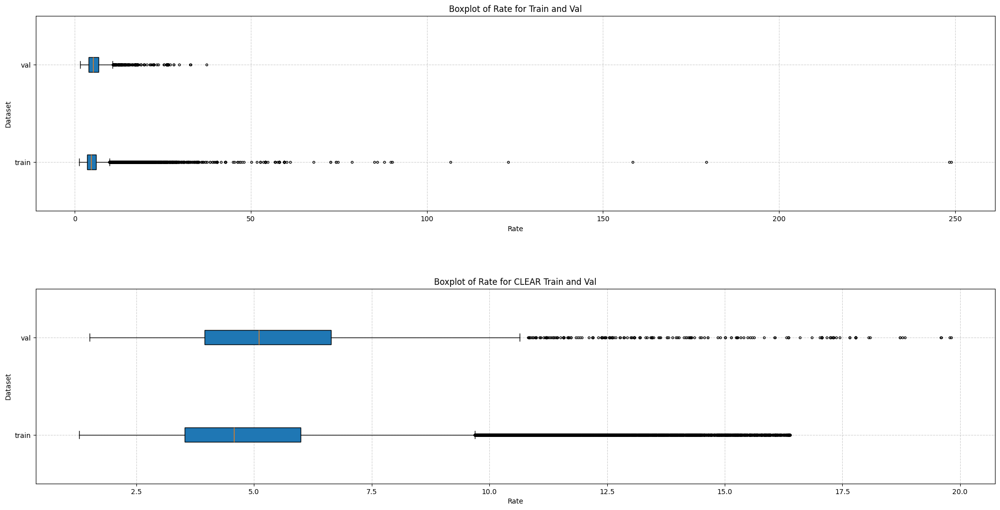

In [23]:
fig, axes = plt.subplots(
    2, 1,
    figsize=(20, 10)
)
fig.tight_layout()
fig.subplots_adjust(
    hspace=.4
)

ax1 = axes[0]
ax2 = axes[1]


ax1.boxplot(
    [train_rate_data, val_rate_data], 
    tick_labels=["train", "val"],
    patch_artist=True,
    vert=False,
    flierprops=dict(marker='o', markersize=3)
)

ax1.set_title("Boxplot of Rate for Train and Val")
ax1.set_xlabel("Rate")
ax1.set_ylabel("Dataset")
ax1.grid(True, linestyle='--', alpha=0.6)


ax2.boxplot(
    [train_rate_data_clear, val_rate_data_clear], 
    tick_labels=["train", "val"],
    patch_artist=True,
    vert=False,
    flierprops=dict(marker='o', markersize=3)
)

ax2.set_title("Boxplot of Rate for CLEAR Train and Val")
ax2.set_xlabel("Rate")
ax2.set_ylabel("Dataset")
ax2.grid(True, linestyle='--', alpha=0.6)


plt.show()

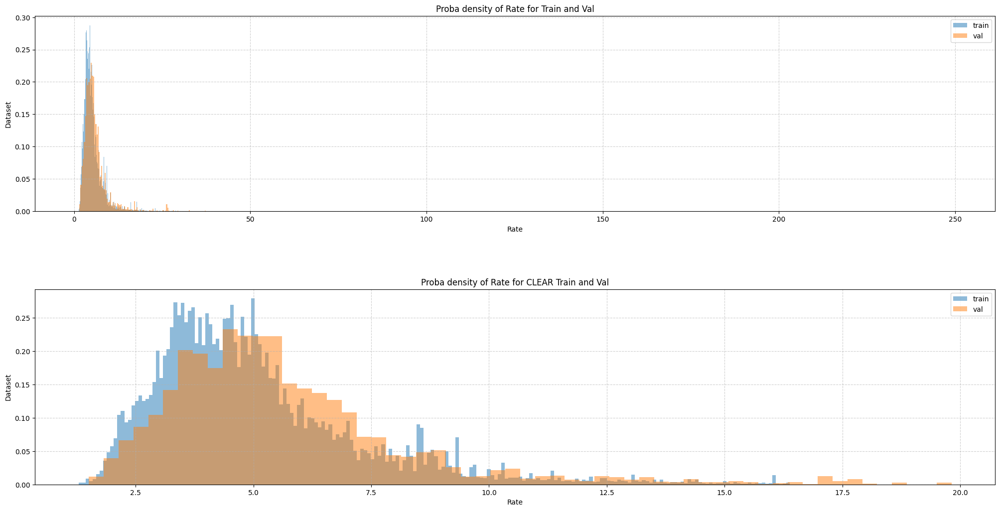

In [24]:
fig, axes = plt.subplots(
    2, 1,
    figsize=(20, 10)
)
fig.tight_layout()
fig.subplots_adjust(
    hspace=.4
)

ax1 = axes[0]
ax2 = axes[1]


ax1.hist(
    x=train_rate_data,
    density=True,
    bins="auto",
    label="train",
    alpha=.5
)
ax1.hist(
    x=val_rate_data,
    density=True,
    bins="auto",
    label="val",
    alpha=.5
)

ax1.set_title("Proba density of Rate for Train and Val")
ax1.set_xlabel("Rate")
ax1.set_ylabel("Dataset")
ax1.grid(True, linestyle='--', alpha=0.6)
ax1.legend(loc="upper right")


ax2.hist(
    x=train_rate_data_clear,
    density=True,
    bins="auto",
    label="train",
    alpha=.5
)
ax2.hist(
    x=val_rate_data_clear,
    density=True,
    bins="auto",
    label="val",
    alpha=.5
)

ax2.set_title("Proba density of Rate for CLEAR Train and Val")
ax2.set_xlabel("Rate")
ax2.set_ylabel("Dataset")
ax2.grid(True, linestyle='--', alpha=0.6)
ax2.legend(loc="upper right")


plt.show()

### log

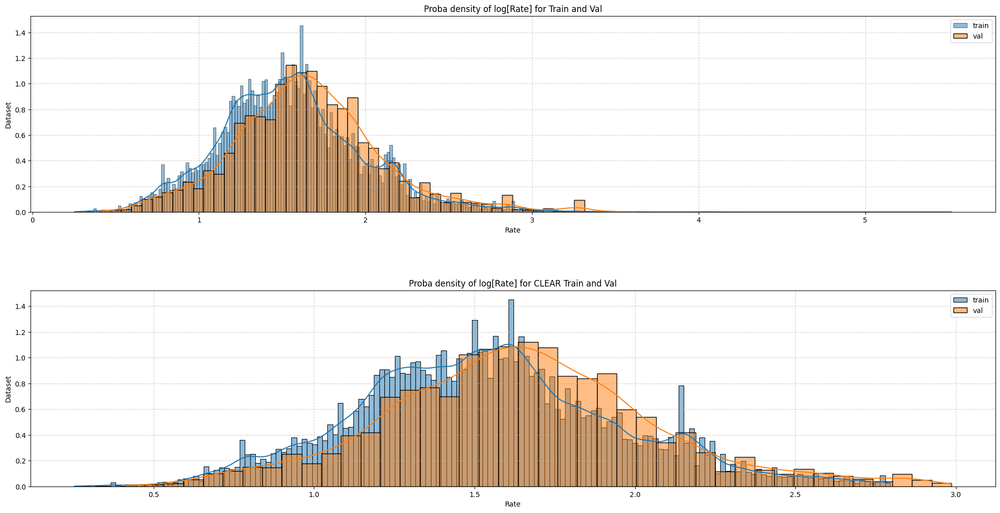

In [25]:
fig, axes = plt.subplots(
   2, 1,
    figsize=(20, 10)
)
fig.tight_layout()
fig.subplots_adjust(
    hspace=.4
)

ax1 = axes[0]
ax2 = axes[1]


sns.histplot(
    x=np.log(train_rate_data),
    stat="density",
    kde=True,
    bins="auto",
    label="train",
    alpha=.5,
    ax=ax1
)

sns.histplot(
    x=np.log(val_rate_data),
    stat="density",
    kde=True,
    bins="auto",
    label="val",
    alpha=.5,
    ax=ax1
)

ax1.set_title("Proba density of log[Rate] for Train and Val")
ax1.set_xlabel("Rate")
ax1.set_ylabel("Dataset")
ax1.grid(True, linestyle='--', alpha=0.6)
ax1.legend(loc="upper right")


sns.histplot(
    x=np.log(train_rate_data_clear),
    stat="density",
    kde=True,
    bins="auto",
    label="train",
    alpha=.5,
    ax=ax2
)

sns.histplot(
    x=np.log(val_rate_data_clear),
    stat="density",
    kde=True,
    bins="auto",
    label="val",
    alpha=.5,
    ax=ax2
)

ax2.set_title("Proba density of log[Rate] for CLEAR Train and Val")
ax2.set_xlabel("Rate")
ax2.set_ylabel("Dataset")
ax2.grid(True, linestyle='--', alpha=0.6)
ax2.legend(loc="upper right")

plt.show()

## valid_miles

In [26]:
train_valid_miles_data = train_data["valid_miles"].values
val_valid_miles_data = val_data["valid_miles"].values
test_valid_miles_data = test_data["valid_miles"].values

train_q01 = np.quantile(train_valid_miles_data, q=.01)
train_q99 = np.quantile(train_valid_miles_data, q=.99) 

val_q01= np.quantile(val_valid_miles_data, q=.01)
val_q99 = np.quantile(val_valid_miles_data, q=.99) 

test_q01= np.quantile(test_valid_miles_data, q=.01)
test_q99 = np.quantile(test_valid_miles_data, q=.99) 


train_valid_miles_data_clear = train_valid_miles_data[
    np.where(
        # (train_q01 <= train_valid_miles_data) & (train_valid_miles_data <= train_q99)
        train_valid_miles_data <= train_q99
    )
]
val_valid_miles_data_clear = val_valid_miles_data[
    np.where(
        # (val_q01 <= val_valid_miles_data) & (val_valid_miles_data <= val_q99)
        val_valid_miles_data <= val_q99
    )
]

test_valid_miles_data_clear = test_valid_miles_data[
    np.where(
        # (test_q01 <= test_valid_miles_data) & (test_valid_miles_data <= test_q99)
        test_valid_miles_data <= test_q99
    )
]

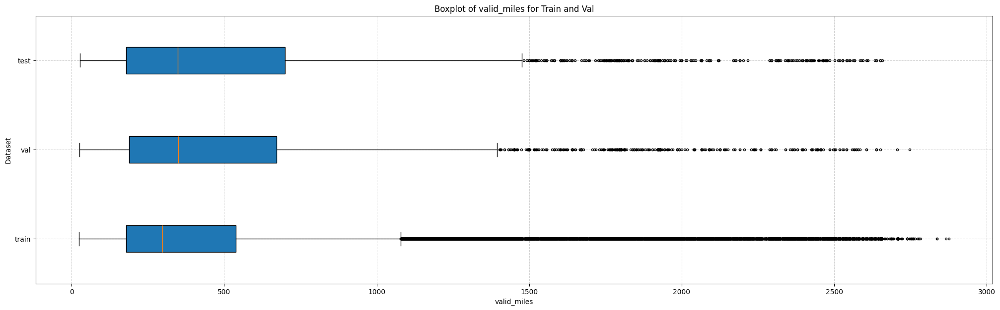

In [27]:
fig, axes = plt.subplots(
    1, 1,
    figsize=(20, 6)
)
fig.tight_layout()
fig.subplots_adjust(
    hspace=.4
)

# ax1 = axes[0]
# ax2 = axes[1]

ax1 = axes


ax1.boxplot(
    [train_valid_miles_data, val_valid_miles_data, test_valid_miles_data], 
    tick_labels=["train", "val", "test"],
    patch_artist=True,
    vert=False,
    flierprops=dict(marker='o', markersize=3)
)

ax1.set_title("Boxplot of valid_miles for Train and Val")
ax1.set_xlabel("valid_miles")
ax1.set_ylabel("Dataset")
ax1.grid(True, linestyle='--', alpha=0.6)


# ax2.boxplot(
#     [train_valid_miles_data_clear, val_valid_miles_data_clear, test_valid_miles_data_clear], 
#     tick_labels=["train", "val", "test"],
#     patch_artist=True,
#     vert=False,
#     flierprops=dict(marker='o', markersize=3)
# )

# ax2.set_title("Boxplot of valid_miles for CLEAR Train and Val")
# ax2.set_xlabel("valid_miles")
# ax2.set_ylabel("Dataset")
# ax2.grid(True, linestyle='--', alpha=0.6)


plt.show()

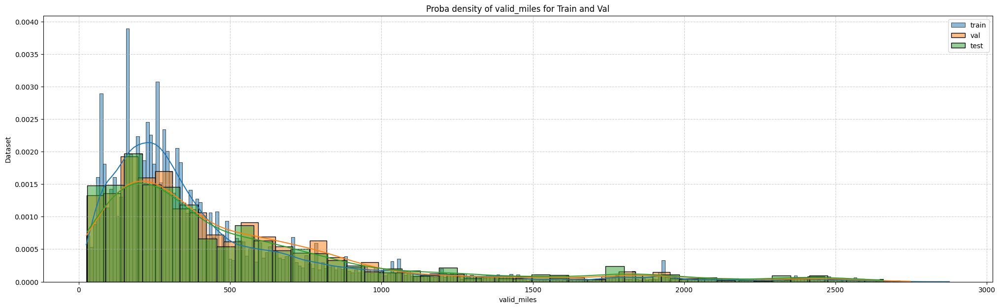

In [28]:
fig, axes = plt.subplots(
    1, 1,
    figsize=(20, 6)
)
fig.tight_layout()
fig.subplots_adjust(
    hspace=.4
)

# ax1 = axes[0]
# ax2 = axes[1]

ax1 = axes

sns.histplot(
    x=train_valid_miles_data,
    stat="density",
    kde=True,
    bins="auto",
    label="train",
    alpha=.5,
    ax=ax1
)
sns.histplot(
    x=val_valid_miles_data,
    stat="density",
    kde=True,
    bins="auto",
    label="val",
    alpha=.5,
    ax=ax1
)
sns.histplot(
    x=test_valid_miles_data,
    stat="density",
    kde=True,
    bins="auto",
    label="test",
    alpha=.5,
    ax=ax1
)

ax1.set_title("Proba density of valid_miles for Train and Val")
ax1.set_xlabel("valid_miles")
ax1.set_ylabel("Dataset")
ax1.grid(True, linestyle='--', alpha=0.6)
ax1.legend()


# sns.histplot(
#     x=train_valid_miles_data_clear,
#     stat="density",
#     kde=True,
#     bins="auto",
#     label="train",
#     alpha=.5,
#     ax=ax2
# )
# sns.histplot(
#     x=val_valid_miles_data_clear,
#     stat="density",
#     kde=True,
#     bins="auto",
#     label="val",
#     alpha=.5,
#     ax=ax2
# )
# sns.histplot(
#     x=test_valid_miles_data_clear,
#     stat="density",
#     kde=True,
#     bins="auto",
#     label="test",
#     alpha=.5,
#     ax=ax2
# )

# ax2.set_title("Proba density of valid_miles for CLEAR Train and Val")
# ax2.set_xlabel("valid_miles")
# ax2.set_ylabel("Dataset")
# ax2.grid(True, linestyle='--', alpha=0.6)
# ax2.legend()


plt.show()

### log

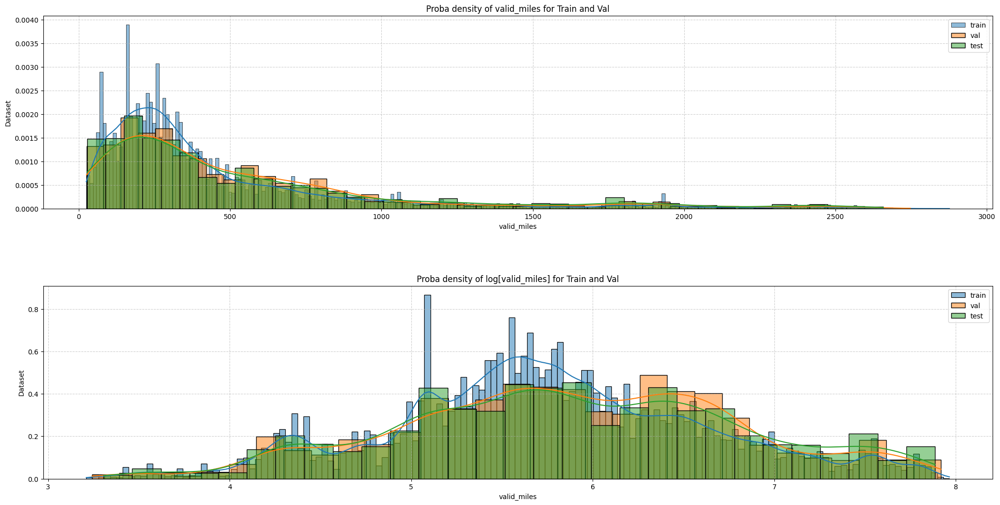

In [29]:
fig, axes = plt.subplots(
   2, 1,
    figsize=(20, 10)
)
fig.tight_layout()
fig.subplots_adjust(
    hspace=.4
)

ax1 = axes[0]
ax2 = axes[1]


sns.histplot(
    x=train_valid_miles_data,
    stat="density",
    kde=True,
    bins="auto",
    label="train",
    alpha=.5,
    ax=ax1
)
sns.histplot(
    x=val_valid_miles_data,
    stat="density",
    kde=True,
    bins="auto",
    label="val",
    alpha=.5,
    ax=ax1
)
sns.histplot(
    x=test_valid_miles_data,
    stat="density",
    kde=True,
    bins="auto",
    label="test",
    alpha=.5,
    ax=ax1
)

ax1.set_title("Proba density of valid_miles for Train and Val")
ax1.set_xlabel("valid_miles")
ax1.set_ylabel("Dataset")
ax1.grid(True, linestyle='--', alpha=0.6)
ax1.legend()


sns.histplot(
    x=np.log(train_valid_miles_data),
    stat="density",
    kde=True,
    bins="auto",
    label="train",
    alpha=.5,
    ax=ax2
)

sns.histplot(
    x=np.log(val_valid_miles_data),
    stat="density",
    kde=True,
    bins="auto",
    label="val",
    alpha=.5,
    ax=ax2
)

sns.histplot(
    x=np.log(test_valid_miles_data),
    stat="density",
    kde=True,
    bins="auto",
    label="test",
    alpha=.5,
    ax=ax2
)

ax2.set_title("Proba density of log[valid_miles] for Train and Val")
ax2.set_xlabel("valid_miles")
ax2.set_ylabel("Dataset")
ax2.grid(True, linestyle='--', alpha=0.6)
ax2.legend()



plt.show()

### rate distplot

Text(0, 0.5, 'log[rate]')

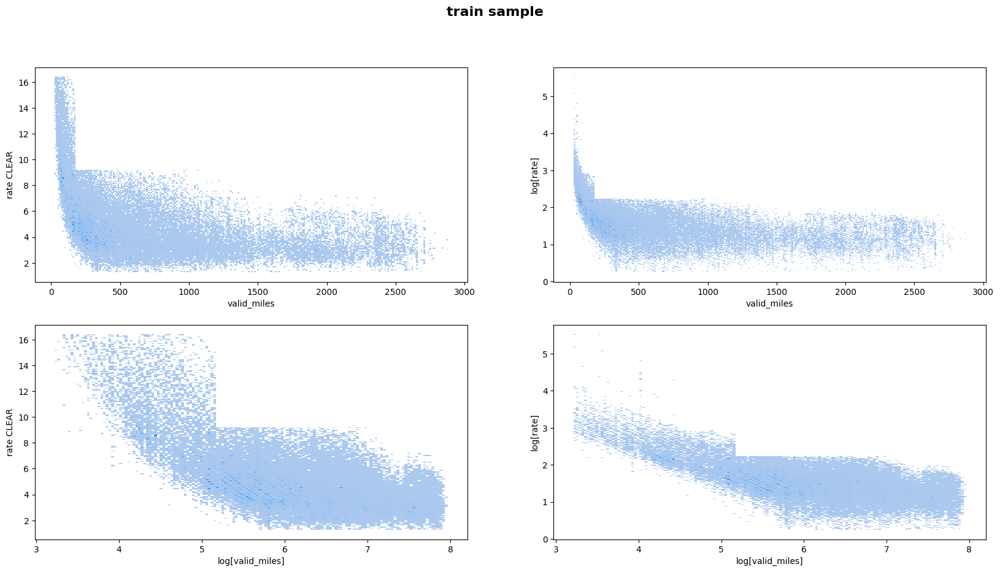

In [46]:
fig, axes = plt.subplots(
    2, 2,
    figsize=(20,10)
)
fig.suptitle("train sample", fontsize=16, weight='bold')

ax1 = axes[0][0]
ax2 = axes[0][1]
ax3 = axes[1][0]
ax4 = axes[1][1]

# ax1.set_title("0,0")
# ax2.set_title("0,1")
# ax3.set_title("1,0")
# ax4.set_title("1,1")

sns.histplot(
    x=train_valid_miles_data[train_rate_idx],
    y=train_rate_data_clear,
    ax=ax1
)
ax1.set_xlabel("valid_miles")
ax1.set_ylabel("rate CLEAR")

sns.histplot(
    x=train_valid_miles_data,
    y=np.log(train_rate_data),
    ax=ax2
)
ax2.set_xlabel("valid_miles")
ax2.set_ylabel("log[rate]")


sns.histplot(
    x=np.log(train_valid_miles_data[train_rate_idx]),
    y=train_rate_data_clear,
    ax=ax3
)
ax3.set_xlabel("log[valid_miles]")
ax3.set_ylabel("rate CLEAR")

sns.histplot(
    x=np.log(train_valid_miles_data),
    y=np.log(train_rate_data),
    ax=ax4
)
ax4.set_xlabel("log[valid_miles]")
ax4.set_ylabel("log[rate]")

Text(0, 0.5, 'log[rate]')

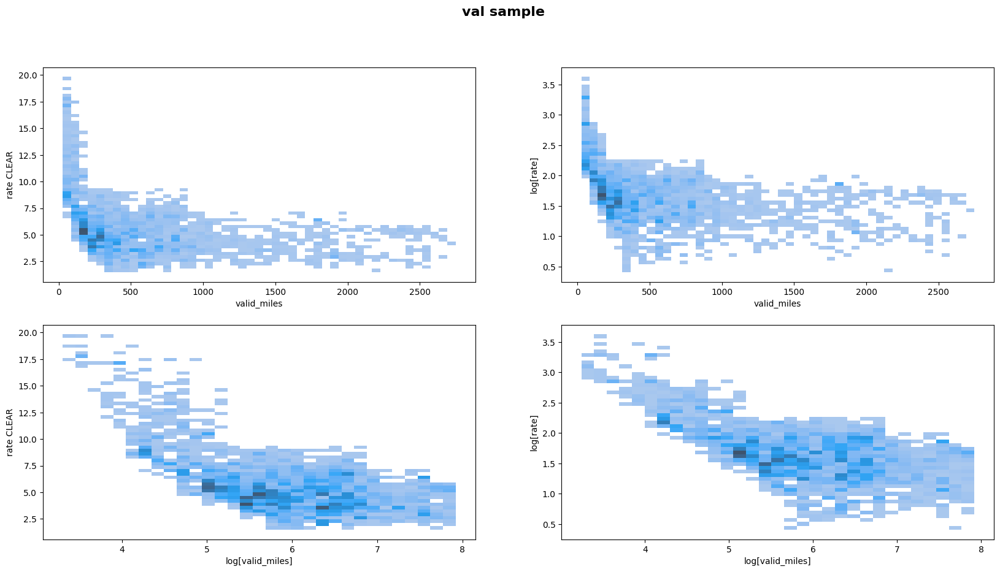

In [47]:
fig, axes = plt.subplots(
    2, 2,
    figsize=(20,10)
)
fig.suptitle("val sample", fontsize=16, weight='bold')

ax1 = axes[0][0]
ax2 = axes[0][1]
ax3 = axes[1][0]
ax4 = axes[1][1]

# ax1.set_title("0,0")
# ax2.set_title("0,1")
# ax3.set_title("1,0")
# ax4.set_title("1,1")

sns.histplot(
    x=val_valid_miles_data[val_rate_idx],
    y=val_rate_data_clear,
    ax=ax1
)
ax1.set_xlabel("valid_miles")
ax1.set_ylabel("rate CLEAR")

sns.histplot(
    x=val_valid_miles_data,
    y=np.log(val_rate_data),
    ax=ax2
)
ax2.set_xlabel("valid_miles")
ax2.set_ylabel("log[rate]")


sns.histplot(
    x=np.log(val_valid_miles_data[val_rate_idx]),
    y=val_rate_data_clear,
    ax=ax3
)
ax3.set_xlabel("log[valid_miles]")
ax3.set_ylabel("rate CLEAR")

sns.histplot(
    x=np.log(val_valid_miles_data),
    y=np.log(val_rate_data),
    ax=ax4
)
ax4.set_xlabel("log[valid_miles]")
ax4.set_ylabel("log[rate]")

## transport_type

In [31]:
train_transport_type = train_data["transport_type"].value_counts(normalize=True)
val_transport_type = val_data["transport_type"].value_counts(normalize=True)
test_transport_type = test_data["transport_type"].value_counts(normalize=True)

In [32]:
fig = go.Figure()

fig.add_trace(
    go.Bar(
        x=train_transport_type.index,
        y=train_transport_type.values,
        text=np.round(train_transport_type.values, 3),
        name="train"
    )
)

fig.add_trace(
    go.Bar(
        x=val_transport_type.index,
        y=val_transport_type.values,
        text=np.round(val_transport_type.values, 3),
        name="val"
    )
)

fig.add_trace(
    go.Bar(
        x=test_transport_type.index,
        y=test_transport_type.values,
        text=np.round(test_transport_type.values, 3),
        name="test"
    )
)

fig.update_layout(
    title="transport_type %"
)

### rate distplot

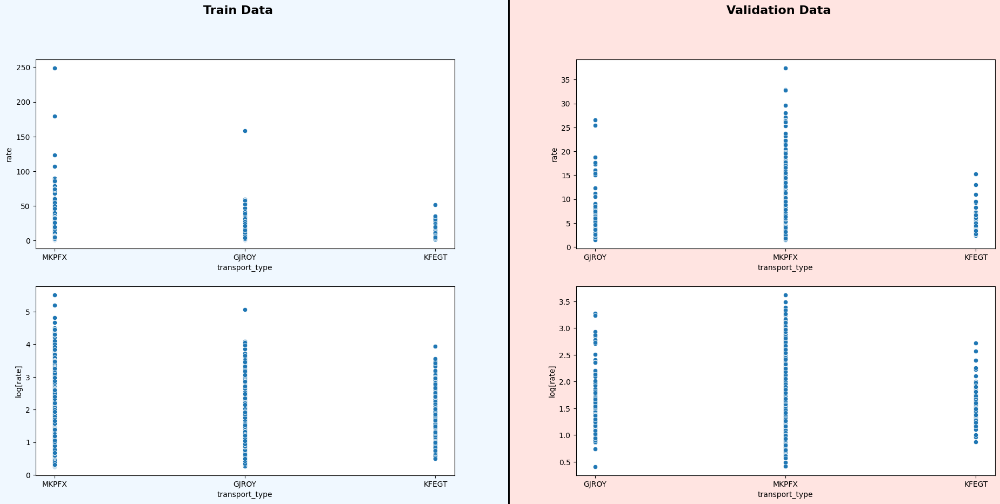

In [44]:
fig, axes = plt.subplots(
    figsize=(20,10)
)
subfigs = fig.subfigures(1, 2, wspace=0.00)

# Background colors for subfigures
subfigs[0].patch.set_facecolor('#f0f8ff')  # Light blue for train
subfigs[1].patch.set_facecolor('#ffe4e1')  # Light pink for valid

# Add borders around subfigures
for subfig in subfigs:
    subfig.suptitle('', fontsize=14, weight='bold')
    subfig.patch.set_edgecolor('black')
    subfig.patch.set_linewidth(2)

subfigs[0].suptitle("Train Data", fontsize=16, weight='bold')
subfigs[1].suptitle("Validation Data", fontsize=16, weight='bold')


axes_train= subfigs[0].subplots(2, 1)
axes_val= subfigs[1].subplots(2, 1)


for axes, temp_data, title in zip([axes_train, axes_val], [train_data, val_data], ["train", "val"]):
    ax1 = axes[0]
    ax2 = axes[1]
    
    
    sns.scatterplot(
        x=temp_data["transport_type"].values,
        y=temp_data["rate"].values,
        ax=ax1
    )
    ax1.set_xlabel("transport_type")
    ax1.set_ylabel("rate")
    
    sns.scatterplot(
        x=temp_data["transport_type"].values,
        y=np.log(temp_data["rate"].values),
        ax=ax2
    )
    ax2.set_xlabel("transport_type")
    ax2.set_ylabel("log[rate]")

## weight

In [33]:
train_weight_data = train_data["weight"].values
val_weight_data = val_data["weight"].values
test_weight_data = test_data["weight"].values

train_q01 = np.quantile(train_weight_data, q=.01)
train_q99 = np.quantile(train_weight_data, q=.99) 

val_q01= np.quantile(val_weight_data, q=.01)
val_q99 = np.quantile(val_weight_data, q=.99) 

test_q01= np.quantile(test_weight_data, q=.01)
test_q99 = np.quantile(test_weight_data, q=.99) 


train_weight_data_clear = train_weight_data[
    np.where(
        # (train_q01 <= train_weight_data) & (train_weight_data <= train_q99)
        train_weight_data <= train_q99
    )
]
val_weight_data_clear = val_weight_data[
    np.where(
        # (val_q01 <= val_weight_data) & (val_weight_data <= val_q99)
        val_weight_data <= val_q99
    )
]

test_weight_data_clear = test_weight_data[
    np.where(
        # (test_q01 <= test_weight_data) & (test_weight_data <= test_q99)
        test_weight_data <= test_q99
    )
]

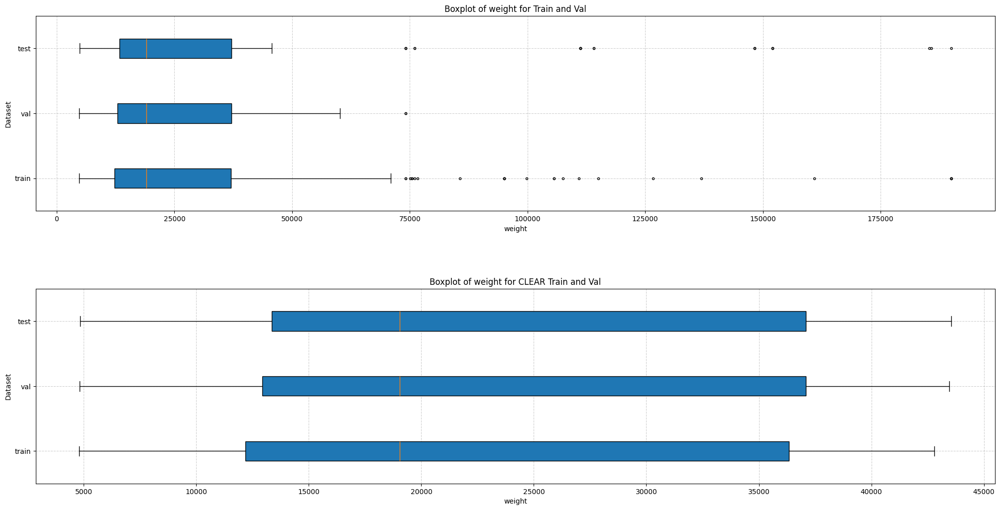

In [34]:
fig, axes = plt.subplots(
    2, 1,
    figsize=(20, 10)
)
fig.tight_layout()
fig.subplots_adjust(
    hspace=.4
)

ax1 = axes[0]
ax2 = axes[1]


ax1.boxplot(
    [train_weight_data, val_weight_data, test_weight_data], 
    tick_labels=["train", "val", "test"],
    patch_artist=True,
    vert=False,
    flierprops=dict(marker='o', markersize=3)
)

ax1.set_title("Boxplot of weight for Train and Val")
ax1.set_xlabel("weight")
ax1.set_ylabel("Dataset")
ax1.grid(True, linestyle='--', alpha=0.6)


ax2.boxplot(
    [train_weight_data_clear, val_weight_data_clear, test_weight_data_clear], 
    tick_labels=["train", "val", "test"],
    patch_artist=True,
    vert=False,
    flierprops=dict(marker='o', markersize=3)
)

ax2.set_title("Boxplot of weight for CLEAR Train and Val")
ax2.set_xlabel("weight")
ax2.set_ylabel("Dataset")
ax2.grid(True, linestyle='--', alpha=0.6)


plt.show()

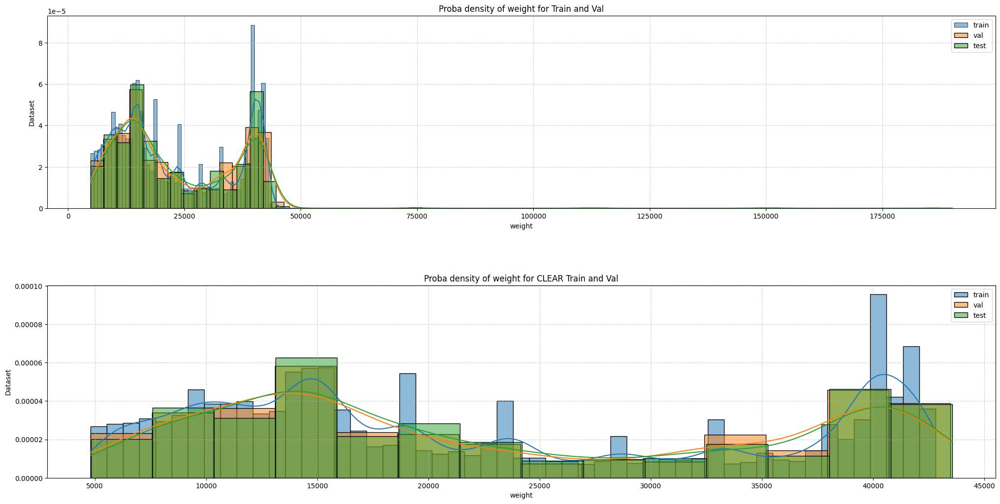

In [56]:
fig, axes = plt.subplots(
    2, 1,
    figsize=(20, 10)
)
fig.tight_layout()
fig.subplots_adjust(
    hspace=.4
)

ax1 = axes[0]
ax2 = axes[1]

sns.histplot(
    x=train_weight_data,
    stat="density",
    kde=True,
    bins="auto",
    label="train",
    alpha=.5,
    ax=ax1
)
sns.histplot(
    x=val_weight_data,
    stat="density",
    kde=True,
    bins="auto",
    label="val",
    alpha=.5,
    ax=ax1
)
sns.histplot(
    x=test_weight_data,
    stat="density",
    kde=True,
    bins="auto",
    label="test",
    alpha=.5,
    ax=ax1
)

ax1.set_title("Proba density of weight for Train and Val")
ax1.set_xlabel("weight")
ax1.set_ylabel("Dataset")
ax1.grid(True, linestyle='--', alpha=0.6)
ax1.legend()


sns.histplot(
    x=train_weight_data_clear,
    stat="density",
    kde=True,
    bins="auto",
    label="train",
    alpha=.5,
    ax=ax2
)
sns.histplot(
    x=val_weight_data_clear,
    stat="density",
    kde=True,
    bins="auto",
    label="val",
    alpha=.5,
    ax=ax2
)
sns.histplot(
    x=test_weight_data_clear,
    stat="density",
    kde=True,
    bins="auto",
    label="test",
    alpha=.5,
    ax=ax2
)

ax2.set_title("Proba density of weight for CLEAR Train and Val")
ax2.set_xlabel("weight")
ax2.set_ylabel("Dataset")
ax2.grid(True, linestyle='--', alpha=0.6)
ax2.legend()


plt.show()

### rate distplot

## pickup_date

In [49]:
train_data["pickup_date"] = pd.to_datetime(train_data["pickup_date"], format="%Y-%m-%d %H:%M:%S")
val_data["pickup_date"] = pd.to_datetime(val_data["pickup_date"], format="%Y-%m-%d %H:%M:%S")
test_data["pickup_date"] = pd.to_datetime(test_data["pickup_date"], format="%Y-%m-%d %H:%M:%S")

In [50]:
train_data["pickup_year"] = train_data["pickup_date"].dt.year
train_data["pickup_month"] = train_data["pickup_date"].dt.month
train_data["pickup_day"] = train_data["pickup_date"].dt.day
train_data["pickup_weekday"] = train_data["pickup_date"].dt.weekday
train_data["pickup_year_month"] = train_data["pickup_date"].dt.to_period("M")
train_data["pickup_year_month_day"] = train_data["pickup_date"].dt.to_period("d")

val_data["pickup_year"] = val_data["pickup_date"].dt.year
val_data["pickup_month"] = val_data["pickup_date"].dt.month
val_data["pickup_day"] = val_data["pickup_date"].dt.day
val_data["pickup_weekday"] = val_data["pickup_date"].dt.weekday
val_data["pickup_year_month"] = val_data["pickup_date"].dt.to_period("M")
val_data["pickup_year_month_day"] = val_data["pickup_date"].dt.to_period("d")

test_data["pickup_year"] = test_data["pickup_date"].dt.year
test_data["pickup_month"] = test_data["pickup_date"].dt.month
test_data["pickup_day"] = test_data["pickup_date"].dt.day
test_data["pickup_weekday"] = test_data["pickup_date"].dt.weekday
test_data["pickup_year_month"] = test_data["pickup_date"].dt.to_period("M")
test_data["pickup_year_month_day"] = test_data["pickup_date"].dt.to_period("d")

### year, month, day, weekday distribution

In [51]:
features_to_plot = ["pickup_year", "pickup_month", "pickup_day", "pickup_weekday"]


fig = make_subplots(
    rows=len(features_to_plot),
    cols=1,
    subplot_titles=features_to_plot
)

for row_idx, target_col in enumerate(features_to_plot):

    for sample_data, sample_label, sample_color in zip([train_data, val_data, test_data], ["train", "val", "test"], ["skyblue", "wheat", "springgreen"]):

        temp_data = sample_data[target_col].value_counts(
            normalize=True
        ).sort_index()

        fig.add_trace(
            go.Bar(
                x=temp_data.index,
                y=temp_data.values,
                text=np.round(temp_data.values, 3),
                marker=dict(
                    color=sample_color
                ),
                name="",
                legendgroup=sample_label,
                legendgrouptitle_text=sample_label,
                showlegend=row_idx==0
            ),
            row=row_idx+1,
            col=1
        )
    fig.update_xaxes(type='category', row=row_idx+1, col=1)

fig.update_layout(
    height=1000
)
fig.show()

#### year-rate distplot

Text(0, 0.5, 'log[rate]')

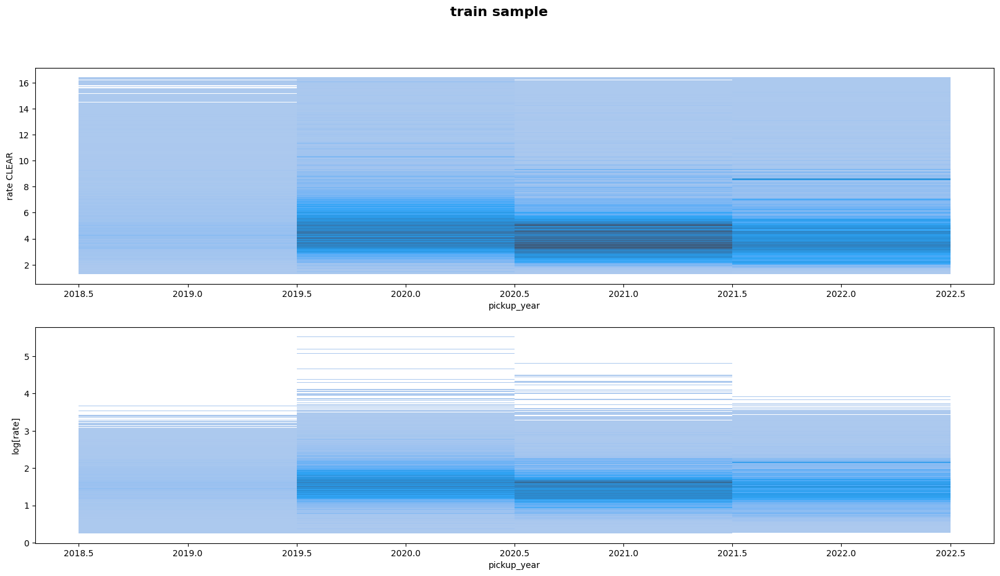

In [65]:
fig, axes = plt.subplots(
    2, 1,
    figsize=(20,10)
)
fig.suptitle("train sample", fontsize=16, weight='bold')

ax1 = axes[0]
ax2 = axes[1]

# ax1.set_title("0,0")
# ax2.set_title("0,1")
# ax3.set_title("1,0")
# ax4.set_title("1,1")

sns.histplot(
    x=train_data["pickup_year"].values[train_rate_idx],
    y=train_rate_data_clear,
    discrete=(True, False),
    ax=ax1
)
ax1.set_xlabel("pickup_year")
ax1.set_ylabel("rate CLEAR")

sns.histplot(
    x=train_data["pickup_year"].values,
    y=np.log(train_rate_data),
    discrete=(True, False),
    ax=ax2
)
ax2.set_xlabel("pickup_year")
ax2.set_ylabel("log[rate]")


#### month-rate distplot

Text(0, 0.5, 'log[rate]')

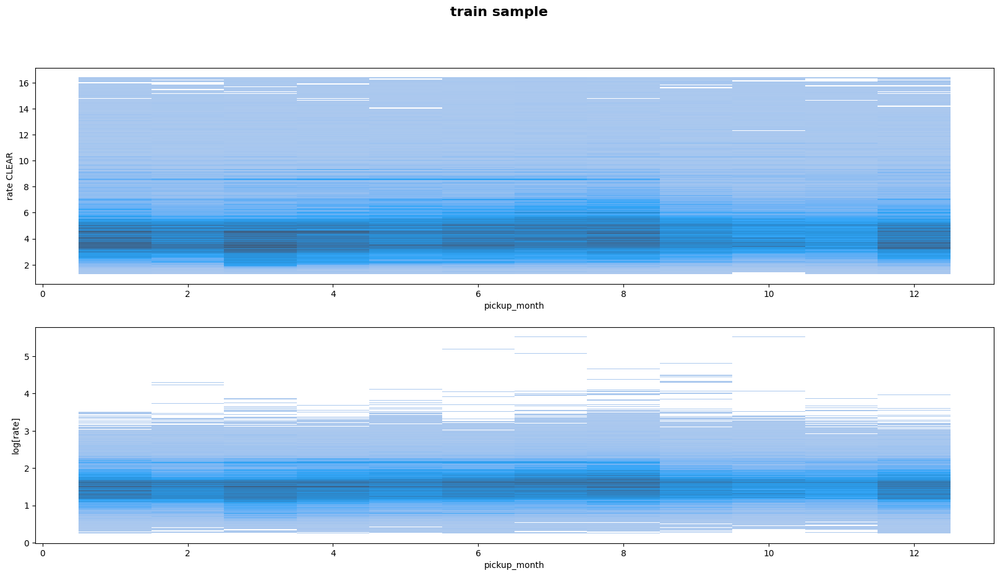

In [66]:
fig, axes = plt.subplots(
    2, 1,
    figsize=(20,10)
)
fig.suptitle("train sample", fontsize=16, weight='bold')

ax1 = axes[0]
ax2 = axes[1]

# ax1.set_title("0,0")
# ax2.set_title("0,1")
# ax3.set_title("1,0")
# ax4.set_title("1,1")

sns.histplot(
    x=train_data["pickup_month"].values[train_rate_idx],
    y=train_rate_data_clear,
    discrete=(True, False),
    ax=ax1
)
ax1.set_xlabel("pickup_month")
ax1.set_ylabel("rate CLEAR")

sns.histplot(
    x=train_data["pickup_month"].values,
    y=np.log(train_rate_data),
    discrete=(True, False),
    ax=ax2
)
ax2.set_xlabel("pickup_month")
ax2.set_ylabel("log[rate]")


#### day-rate distplot

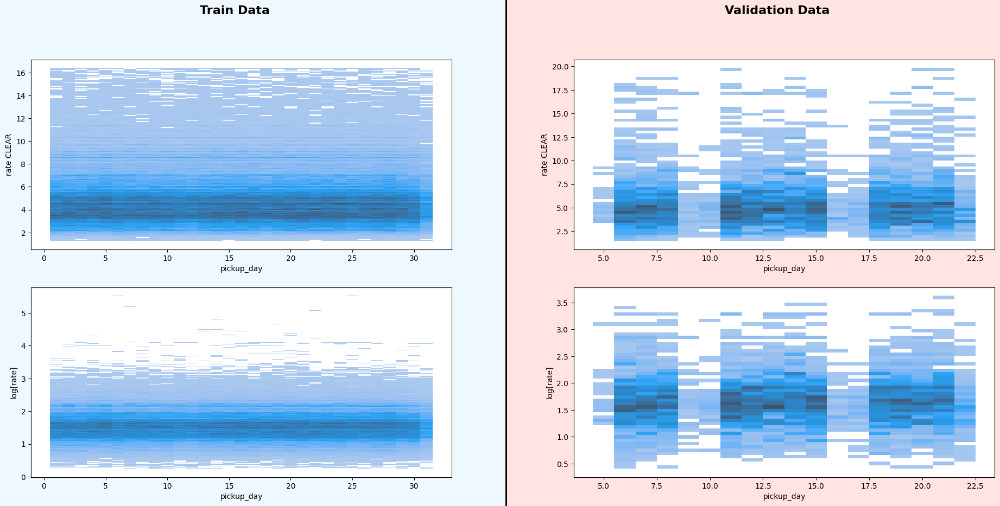

In [67]:
fig, axes = plt.subplots(
    figsize=(20,10)
)
subfigs = fig.subfigures(1, 2, wspace=0.00)

# Background colors for subfigures
subfigs[0].patch.set_facecolor('#f0f8ff')  # Light blue for train
subfigs[1].patch.set_facecolor('#ffe4e1')  # Light pink for valid

# Add borders around subfigures
for subfig in subfigs:
    subfig.suptitle('', fontsize=14, weight='bold')
    subfig.patch.set_edgecolor('black')
    subfig.patch.set_linewidth(2)

subfigs[0].suptitle("Train Data", fontsize=16, weight='bold')
subfigs[1].suptitle("Validation Data", fontsize=16, weight='bold')


axes_train= subfigs[0].subplots(2, 1)
axes_val= subfigs[1].subplots(2, 1)


for axes, (temp_data_upper, temp_data_lower) in zip(
    [axes_train, axes_val],
    
    [((train_data["pickup_day"].values[train_rate_idx], train_rate_data_clear,), (train_data["pickup_day"].values, np.log(train_rate_data))), ((val_data["pickup_day"].values[val_rate_idx], val_rate_data_clear,), (val_data["pickup_day"].values, np.log(val_rate_data)))],
):
    ax1 = axes[0]
    ax2 = axes[1]

    sns.histplot(
        x=temp_data_upper[0],
        y=temp_data_upper[1],
        discrete=(True, False),
        ax=ax1
    )
    ax1.set_xlabel("pickup_day")
    ax1.set_ylabel("rate CLEAR")
    
    sns.histplot(
        x=temp_data_lower[0],
        y=temp_data_lower[1],
        discrete=(True, False),
        ax=ax2
    )
    ax2.set_xlabel("pickup_day")
    ax2.set_ylabel("log[rate]")
    

#### weekday-rate distplot

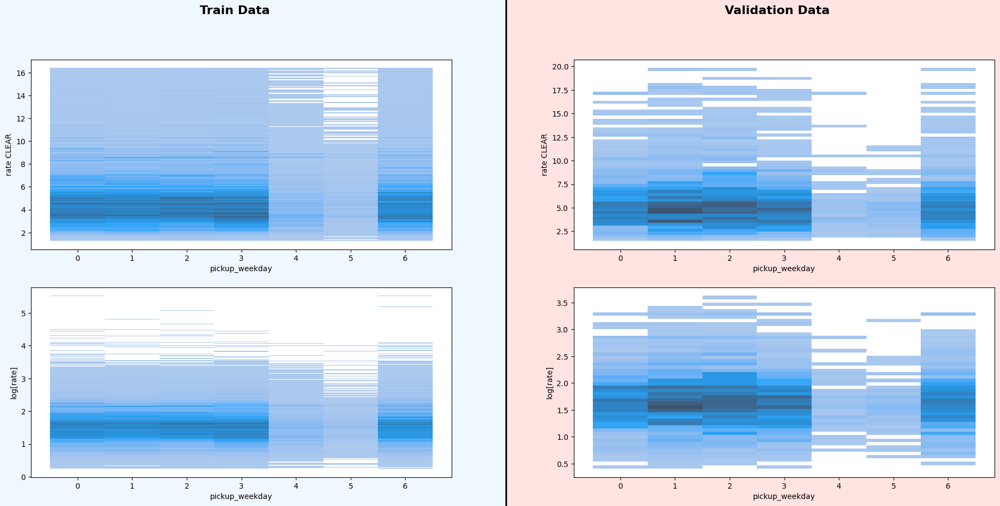

In [68]:
fig, axes = plt.subplots(
    figsize=(20,10)
)
subfigs = fig.subfigures(1, 2, wspace=0.00)

# Background colors for subfigures
subfigs[0].patch.set_facecolor('#f0f8ff')  # Light blue for train
subfigs[1].patch.set_facecolor('#ffe4e1')  # Light pink for valid

# Add borders around subfigures
for subfig in subfigs:
    subfig.suptitle('', fontsize=14, weight='bold')
    subfig.patch.set_edgecolor('black')
    subfig.patch.set_linewidth(2)

subfigs[0].suptitle("Train Data", fontsize=16, weight='bold')
subfigs[1].suptitle("Validation Data", fontsize=16, weight='bold')


axes_train= subfigs[0].subplots(2, 1)
axes_val= subfigs[1].subplots(2, 1)


for axes, (temp_data_upper, temp_data_lower) in zip(
    [axes_train, axes_val],
    
    [((train_data["pickup_weekday"].values[train_rate_idx], train_rate_data_clear,), (train_data["pickup_weekday"].values, np.log(train_rate_data))), ((val_data["pickup_weekday"].values[val_rate_idx], val_rate_data_clear,), (val_data["pickup_weekday"].values, np.log(val_rate_data)))],
):
    ax1 = axes[0]
    ax2 = axes[1]

    sns.histplot(
        x=temp_data_upper[0],
        y=temp_data_upper[1],
        discrete=(True, False),
        ax=ax1
    )
    ax1.set_xlabel("pickup_weekday")
    ax1.set_ylabel("rate CLEAR")
    
    sns.histplot(
        x=temp_data_lower[0],
        y=temp_data_lower[1],
        discrete=(True, False),
        ax=ax2
    )
    ax2.set_xlabel("pickup_weekday")
    ax2.set_ylabel("log[rate]")
    

### year-month distribution

In [52]:
features_to_plot = ["pickup_year_month"]


fig = make_subplots(
    rows=len(features_to_plot),
    cols=1,
    subplot_titles=features_to_plot
)

for row_idx, target_col in enumerate(features_to_plot):

    for sample_data, sample_label, sample_color in zip([train_data, val_data, test_data], ["train", "val", "test"], ["skyblue", "wheat", "springgreen"]):

        temp_data = sample_data[target_col].value_counts(
            normalize=True
        ).sort_index()

        fig.add_trace(
            go.Bar(
                x=temp_data.index.astype("str"),
                y=temp_data.values,
                text=np.round(temp_data.values, 3),
                marker=dict(
                    color=sample_color
                ),
                name="",
                legendgroup=sample_label,
                legendgrouptitle_text=sample_label,
                showlegend=row_idx==0
            ),
            row=row_idx+1,
            col=1
        )
    fig.update_xaxes(type='category', row=row_idx+1, col=1)

fig.update_layout(
    height=600
)
fig.show()

#### rate distplot

Text(0, 0.5, 'log[rate]')

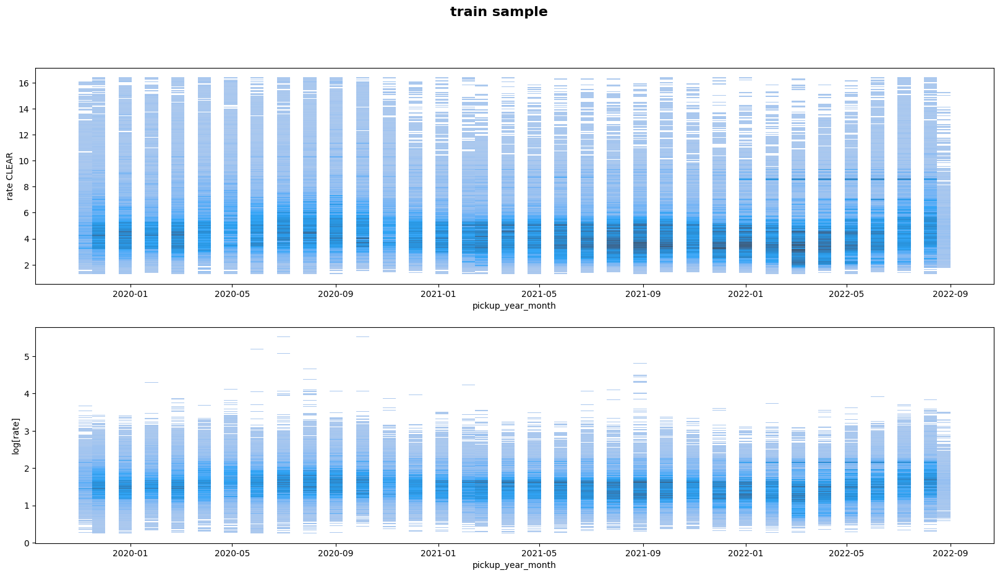

In [62]:
fig, axes = plt.subplots(
    2, 1,
    figsize=(20,10)
)
fig.suptitle("train sample", fontsize=16, weight='bold')

ax1 = axes[0]
ax2 = axes[1]

# ax1.set_title("0,0")
# ax2.set_title("0,1")
# ax3.set_title("1,0")
# ax4.set_title("1,1")

sns.histplot(
    x=train_data["pickup_year_month"].dt.to_timestamp().values[train_rate_idx],
    y=train_rate_data_clear,
    ax=ax1
)
ax1.set_xlabel("pickup_year_month")
ax1.set_ylabel("rate CLEAR")

sns.histplot(
    x=train_data["pickup_year_month"].dt.to_timestamp().values,
    y=np.log(train_rate_data),
    ax=ax2
)
ax2.set_xlabel("pickup_year_month")
ax2.set_ylabel("log[rate]")


### year-month-day distr

In [53]:
fig = go.Figure()


for weekday_num, weekday_data in train_data.groupby(by="pickup_weekday")["pickup_year_month_day"]:

    temp_data = weekday_data.value_counts(
            normalize=False
        ).sort_index()

    fig.add_trace(
            go.Scatter(
                x=temp_data.index.to_timestamp(),
                y=temp_data.values,
                mode="markers",
                name=f"weekday {weekday_num}"
            )
        )

fig.update_layout(
    height=600,
    title="train sample"
)
fig.show()

#### rate distplot

Text(0, 0.5, 'log[rate]')

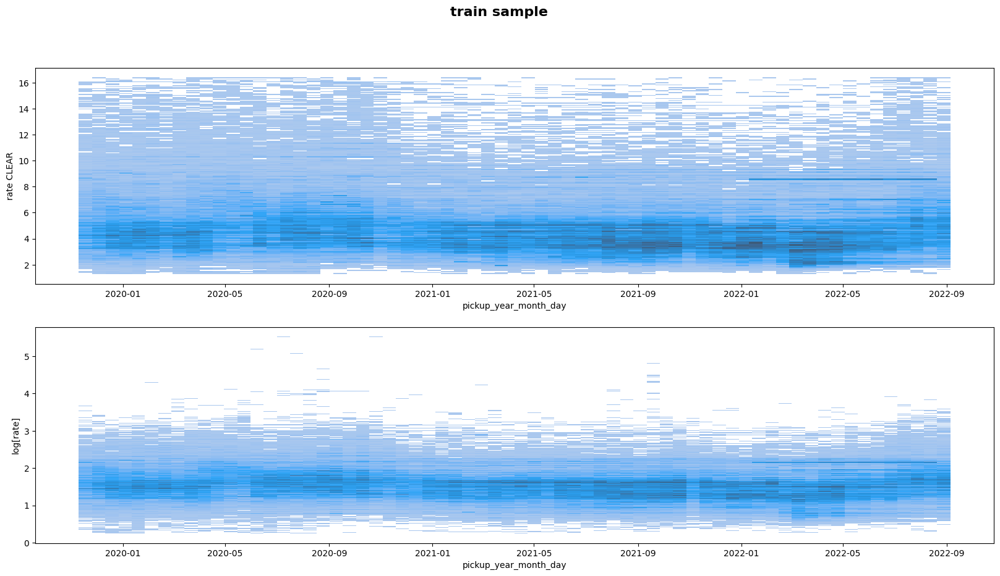

In [61]:
fig, axes = plt.subplots(
    2, 1,
    figsize=(20,10)
)
fig.suptitle("train sample", fontsize=16, weight='bold')

ax1 = axes[0]
ax2 = axes[1]

# ax1.set_title("0,0")
# ax2.set_title("0,1")
# ax3.set_title("1,0")
# ax4.set_title("1,1")

sns.histplot(
    x=train_data["pickup_year_month_day"].dt.to_timestamp().values[train_rate_idx],
    y=train_rate_data_clear,
    ax=ax1
)
ax1.set_xlabel("pickup_year_month_day")
ax1.set_ylabel("rate CLEAR")

sns.histplot(
    x=train_data["pickup_year_month_day"].dt.to_timestamp().values,
    y=np.log(train_rate_data),
    ax=ax2
)
ax2.set_xlabel("pickup_year_month_day")
ax2.set_ylabel("log[rate]")


## origin_kma & destination_kma

### origin

In [82]:
train_origin_kma = train_data["origin_kma"].unique()
val_origin_kma = val_data["origin_kma"].unique()
test_origin_kma = test_data["origin_kma"].unique()

assert np.all(np.isin(val_origin_kma, train_origin_kma))
assert np.all(np.isin(test_origin_kma, train_origin_kma))

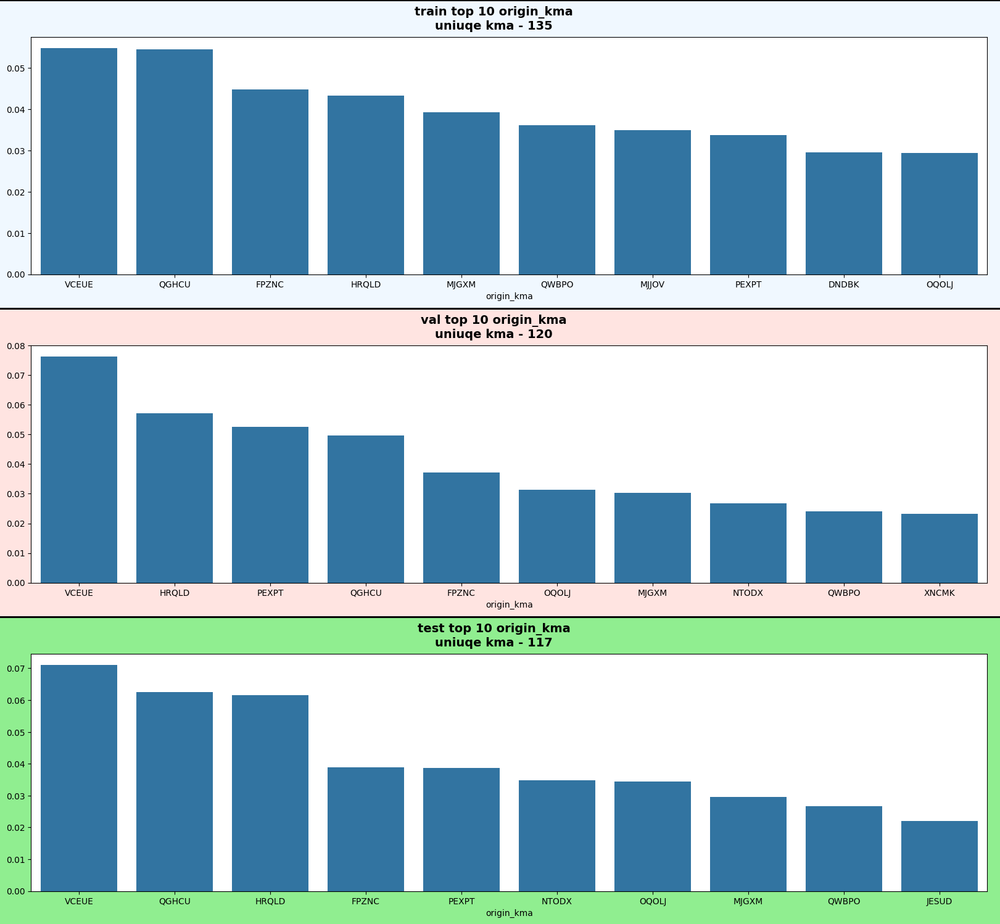

In [75]:
fig, axes = plt.subplots(
    figsize=(20,15)
)
subfigs = fig.subfigures(3, 1, hspace=0.00)

# Background colors for subfigures
subfigs[0].patch.set_facecolor('#f0f8ff')  # Light blue for train
subfigs[1].patch.set_facecolor('#ffe4e1')  # Light pink for valid
subfigs[2].patch.set_facecolor('#90EE90')  # Light green for test

# Add borders around subfigures
for subfig, sample_data, sample_title in zip(subfigs, [train_data, val_data, test_data], ["train", "val", "test"]):

    temp_data = sample_data["origin_kma"].value_counts(
        normalize=True,
        sort=True,
        ascending=False
    )


    subfig.suptitle(sample_title + " top 10 origin_kma" + f"\nuniuqe kma - {temp_data.shape[0]}", fontsize=14, weight='bold')
    subfig.patch.set_edgecolor('black')
    subfig.patch.set_linewidth(2)

    axis = subfig.subplots(1, 1)
    sns.barplot(
        x=temp_data.head(10).index, 
        y=temp_data.head(10).values,
        ax=axis
    )

# subfigs[0].suptitle("Train Data", fontsize=16, weight='bold')
# subfigs[1].suptitle("Validation Data", fontsize=16, weight='bold')

### destination

In [83]:
train_destination_kma = train_data["destination_kma"].unique()
val_destination_kma = val_data["destination_kma"].unique()
test_destination_kma = test_data["destination_kma"].unique()

assert np.all(np.isin(val_destination_kma, train_destination_kma))
assert np.all(np.isin(test_destination_kma, train_destination_kma))

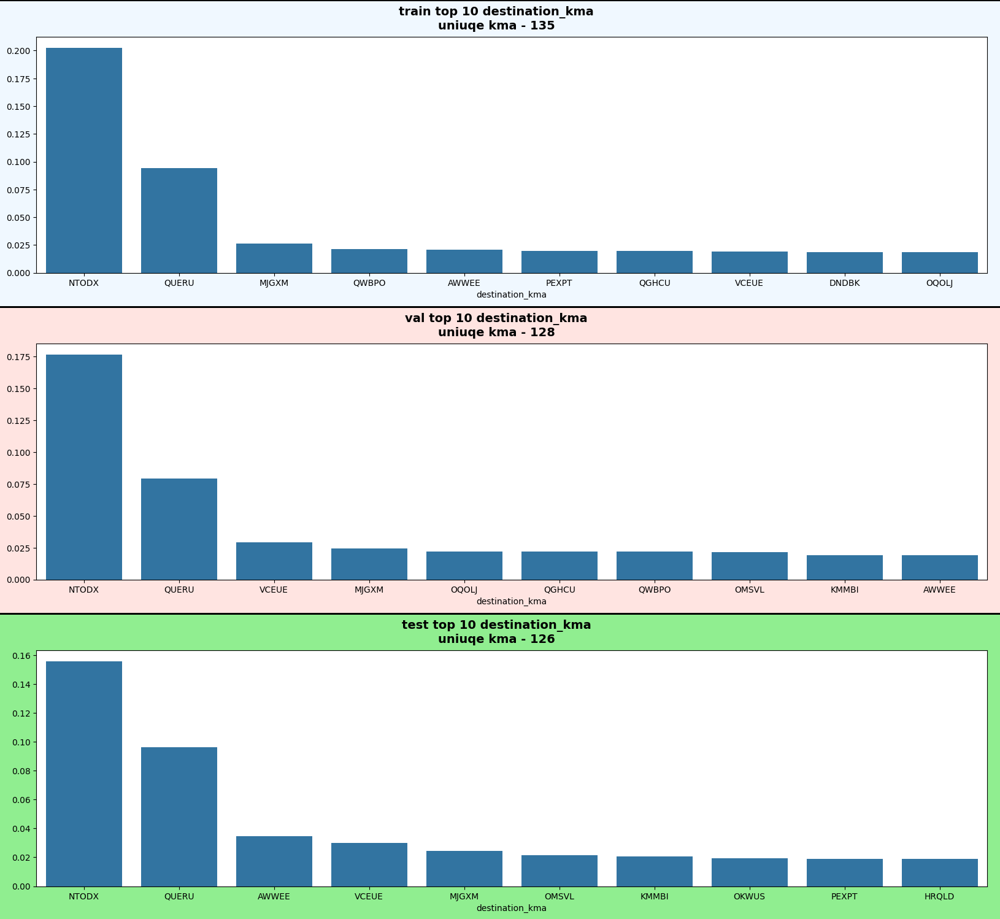

In [84]:
fig, axes = plt.subplots(
    figsize=(20,15)
)
subfigs = fig.subfigures(3, 1, hspace=0.00)

# Background colors for subfigures
subfigs[0].patch.set_facecolor('#f0f8ff')  # Light blue for train
subfigs[1].patch.set_facecolor('#ffe4e1')  # Light pink for valid
subfigs[2].patch.set_facecolor('#90EE90')  # Light green for test

# Add borders around subfigures
for subfig, sample_data, sample_title in zip(subfigs, [train_data, val_data, test_data], ["train", "val", "test"]):

    temp_data = sample_data["destination_kma"].value_counts(
        normalize=True,
        sort=True,
        ascending=False
    )


    subfig.suptitle(sample_title + " top 10 destination_kma" + f"\nuniuqe kma - {temp_data.shape[0]}", fontsize=14, weight='bold')
    subfig.patch.set_edgecolor('black')
    subfig.patch.set_linewidth(2)

    axis = subfig.subplots(1, 1)
    sns.barplot(
        x=temp_data.head(10).index, 
        y=temp_data.head(10).values,
        ax=axis
    )

# subfigs[0].suptitle("Train Data", fontsize=16, weight='bold')
# subfigs[1].suptitle("Validation Data", fontsize=16, weight='bold')

### route

In [86]:
train_data["route"] = train_data["origin_kma"] + " → " + train_data["destination_kma"]

val_data["route"] = val_data["origin_kma"] + " → " + val_data["destination_kma"]

test_data["route"] = test_data["origin_kma"] + " → " + test_data["destination_kma"]

In [89]:
train_route = train_data["route"].unique()
val_route = val_data["route"].unique()
test_route = test_data["route"].unique()

assert np.all(np.isin(val_route, train_route))
assert np.all(np.isin(test_route, train_route))

AssertionError: 